# Kilonova modelling from scratch

**Abstract:** NMMA allows users to build kilonova models. In case you want to get your hands dirty and adapt or extend the kilonova modelling, it could be helpful to break down the source code and see the intermediate steps that are performed in building these models to for instance gain insight into the training data. This notebook shows the different preprocessing steps before building the models as guideline to users. 

In [1]:
# Basic imports
#general modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os, sys, time, glob
from astropy.time import Time
import copy
import scipy
#nmma modules
sys.path.append('/Users/Woute029/Code/nmma') #path to nmma
import nmma
from nmma.em import training
import afterglowpy as grb

import h5py
import pickle

## Exploring and preprocessing data

Specify the location of the lightcurves that are used as grid for interpolation. 

In [2]:
# Location of the kilonova lightcurves
lcs_dir = "/Users/Woute029/Documents/KN_Lightcurves/lightcurves/lcs_bulla_2022"
filenames = os.listdir(lcs_dir)
full_filenames = [os.path.join(lcs_dir, f) for f in filenames]

To briefly explore the lightcurve data, let us load in a single lightcurve. Note the formatting: this is also what is written in `nmma/em/io` that can process lightcurve files. For convenience, we rename the first column.

In [3]:
dat = pd.read_csv(os.path.join(lcs_dir, filenames[0]), delimiter=" ", escapechar='#')
dat = dat.rename(columns={" t[days]": "t"})
dat

,t,bessellux,bessellb,bessellv,bessellr,besselli,sdssu,ps1::g,ps1::r,ps1::i,...,uvot::white,atlasc,atlaso,2massj,2massh,2massks,ztfg,ztfr,ztfi,Unnamed: 27
0,0.103,-15.361,-15.377,-15.192,-14.957,-15.142,-15.400,-15.083,-15.069,-14.145,...,-15.522,-15.189,-14.757,-14.788,-11.856,12.727,-15.223,-14.879,-14.911,NaN
1,0.109,-17.981,-18.327,-17.994,-17.865,-17.313,-18.045,-18.107,-17.978,-17.423,...,-18.421,-17.913,-17.795,-13.012,-13.678,-3.248,-18.047,-17.902,-17.417,NaN
2,0.116,-18.303,-17.752,-17.570,-17.637,-17.101,-18.346,-17.857,-17.512,-17.707,...,-18.376,-17.727,-17.652,-13.518,-16.154,-11.411,-17.893,-17.696,-17.301,NaN
3,0.122,-18.193,-17.729,-17.856,-17.870,-17.120,-18.175,-17.523,-17.874,-16.992,...,-18.381,-17.791,-17.614,-16.271,-17.455,-15.149,-17.562,-17.835,-16.881,NaN
4,0.130,-18.391,-18.425,-17.740,-17.651,-17.797,-18.361,-18.217,-17.755,-17.160,...,-18.325,-18.074,-17.532,-16.811,-13.814,-5.180,-18.237,-17.698,-17.634,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,24.532,NaN,42.820,8.469,-2.312,-5.455,8.423,39.215,6.848,-4.753,...,5.030,7.731,-3.712,-10.826,-11.521,-12.430,42.057,3.580,-5.235,NaN
96,25.987,NaN,25.400,7.332,-2.066,-4.865,2.813,21.797,7.107,-4.196,...,4.159,7.712,-3.199,-10.564,-11.189,-12.299,24.640,3.563,-4.719,NaN
97,27.528,NaN,49.912,19.402,-0.635,-3.525,7.795,48.103,14.768,-2.628,...,5.195,NaN,-1.617,-10.265,-11.054,-12.045,47.556,14.391,-3.027,NaN
98,29.160,58.756,NaN,3.824,-1.581,-3.732,2.394,49.495,-0.689,-3.339,...,3.222,NaN,-2.510,-9.888,-10.604,-11.653,50.387,-0.605,-3.504,NaN


In [4]:
print(dat.columns)
value_columns = dat.columns[1:-1]
print(value_columns)

Index(['t', 'bessellux', 'bessellb', 'bessellv', 'bessellr', 'besselli',
       'sdssu', 'ps1::g', 'ps1::r', 'ps1::i', 'ps1::z', 'ps1::y', 'uvot::b',
       'uvot::u', 'uvot::uvm2', 'uvot::uvw1', 'uvot::uvw2', 'uvot::v',
       'uvot::white', 'atlasc', 'atlaso', '2massj', '2massh', '2massks',
       'ztfg', 'ztfr', 'ztfi', 'Unnamed: 27'],
      dtype='object')
Index(['bessellux', 'bessellb', 'bessellv', 'bessellr', 'besselli', 'sdssu',
       'ps1::g', 'ps1::r', 'ps1::i', 'ps1::z', 'ps1::y', 'uvot::b', 'uvot::u',
       'uvot::uvm2', 'uvot::uvw1', 'uvot::uvw2', 'uvot::v', 'uvot::white',
       'atlasc', 'atlaso', '2massj', '2massh', '2massks', 'ztfg', 'ztfr',
       'ztfi'],
      dtype='object')


Below, we show the plot of a single lightcurve.

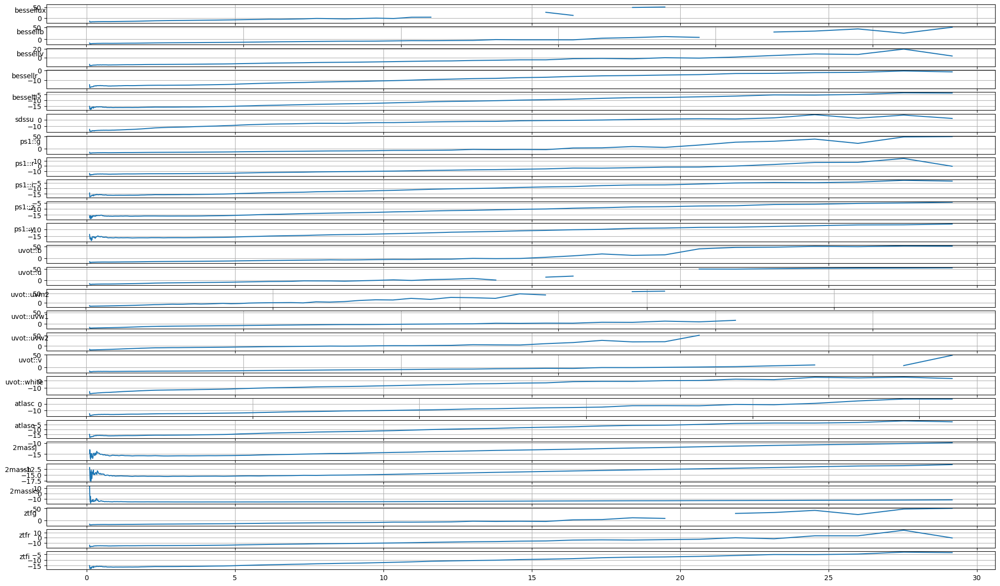

In [5]:
nrow = len(value_columns)
plt.subplots(nrow, 1, figsize=(25, 15), sharex = True)
t = dat["t"].values

for i, key in enumerate(value_columns):
    plt.subplot(nrow, 1, i+1)
    plt.plot(t, dat[key].values)
    plt.ylabel(key, rotation=0)
    plt.grid()
plt.show()

Have to get the parameters out with NMMA. To read and process a bunch of photometry files as the above directory, use the `read_photometry_files` function from NMMA from the `io` script. This creates a dictionary with keys being the filenames of youyr lightcurves, and values being the above Pandas dataframe as dictionary. **Note:** This can take a while if you have a large grid.

In [6]:
from nmma.em.io import read_photometry_files
from nmma.em.utils import interpolate_nans

Install wrapt_timeout_decorator if you want timeout simulations.


In [7]:
data = read_photometry_files(full_filenames)

In [8]:
# Interpolate nans
data = interpolate_nans(data)

In order to process the data, NMMA needs to know which kind of data file you are using. This is needed in order to extract the parameters out of the filenames. In `model_parameters`, there is an overview of which lightcurves are supported for extracting the parameters:

In [9]:
import inspect 
import nmma.em.model_parameters as model_parameters

MODEL_FUNCTIONS = {
    k: v for k, v in model_parameters.__dict__.items() if inspect.isfunction(v)
}
MODEL_FUNCTIONS

{'get_knprops_from_LANLfilename': <function nmma.em.utils.get_knprops_from_LANLfilename(filename)>,
 'AnBa2022_linear': <function nmma.em.model_parameters.AnBa2022_linear(data)>,
 'AnBa2022_log': <function nmma.em.model_parameters.AnBa2022_log(data)>,
 'AnBa2022_sparse': <function nmma.em.model_parameters.AnBa2022_sparse(data)>,
 'CV': <function nmma.em.model_parameters.CV(data)>,
 'Bu2019lm_sparse': <function nmma.em.model_parameters.Bu2019lm_sparse(data)>,
 'Bu2019lm': <function nmma.em.model_parameters.Bu2019lm(data)>,
 'Bu2019nsbh': <function nmma.em.model_parameters.Bu2019nsbh(data)>,
 'Bu2022Ye': <function nmma.em.model_parameters.Bu2022Ye(data)>,
 'Ka2017': <function nmma.em.model_parameters.Ka2017(data)>,
 'LANL2022': <function nmma.em.model_parameters.LANL2022(data)>}

We are using `Bu2022Ye`, so get the function to extract its parameters:

In [10]:
model_name = "Bu2022Ye"
model_function = MODEL_FUNCTIONS[model_name]

Then, preprocess the data into training data with parameters

In [11]:
training_data, parameters = model_function(data)

In [12]:
training_data

{'nph1.0e+06_dyn0.005-0.12-0.30_wind0.050-0.03_theta25.84_dMpc0': {'log10_mej_dyn': -2.3010299956639813,
  'vej_dyn': 0.12,
  'Yedyn': 0.3,
  'log10_mej_wind': -1.3010299956639813,
  'vej_wind': 0.03,
  'KNtheta': 25.84,
  't': array([ 0.103,  0.109,  0.116,  0.122,  0.13 ,  0.137,  0.145,  0.154,
          0.163,  0.173,  0.183,  0.194,  0.206,  0.218,  0.231,  0.244,
          0.259,  0.274,  0.29 ,  0.308,  0.326,  0.345,  0.366,  0.387,
          0.41 ,  0.435,  0.461,  0.488,  0.517,  0.547,  0.58 ,  0.614,
          0.651,  0.689,  0.73 ,  0.773,  0.819,  0.868,  0.919,  0.974,
          1.032,  1.093,  1.158,  1.226,  1.299,  1.376,  1.458,  1.544,
          1.636,  1.733,  1.836,  1.944,  2.06 ,  2.182,  2.311,  2.448,
          2.594,  2.747,  2.91 ,  3.083,  3.266,  3.459,  3.665,  3.882,
          4.112,  4.356,  4.614,  4.888,  5.178,  5.485,  5.81 ,  6.155,
          6.52 ,  6.906,  7.316,  7.75 ,  8.21 ,  8.696,  9.212,  9.759,
         10.337, 10.95 , 11.6  , 12.288, 13.

In [13]:
parameters

['log10_mej_dyn', 'vej_dyn', 'Yedyn', 'log10_mej_wind', 'vej_wind', 'KNtheta']

Get the filters that are used (by default, NMMA will use all available filters, which can be found as follows:)

In [14]:
keys = list(data.keys())
filts = sorted(list(set(data[keys[0]].keys()) - {"t"}))
print(filts)

['2massh', '2massj', '2massks', 'atlasc', 'atlaso', 'bessellb', 'besselli', 'bessellr', 'bessellux', 'bessellv', 'ps1__g', 'ps1__i', 'ps1__r', 'ps1__y', 'ps1__z', 'sdssu', 'uvot__b', 'uvot__u', 'uvot__uvm2', 'uvot__uvw1', 'uvot__uvw2', 'uvot__v', 'uvot__white', 'ztfg', 'ztfi', 'ztfr']


## Training SVD model

Interpolation is done with an `SVDTrainingModel` object. Note that the initialization function immediately calls `interpolate_data` and starts training the model. 

In [15]:
from nmma.em.training import SVDTrainingModel

In [16]:
svd_ncoeff = 10

training_model = SVDTrainingModel(
        model_name,
        training_data,
        parameters,
        t,
        filts,
        n_coeff=svd_ncoeff,
        interpolation_type="tensorflow",
    )

The grid will be interpolated to sample_time with interp1d
Training new model
Normalizing mag filter 2massh...
Normalizing mag filter 2massj...
Normalizing mag filter 2massks...
Normalizing mag filter atlasc...
Normalizing mag filter atlaso...
Normalizing mag filter bessellb...
Normalizing mag filter besselli...
Normalizing mag filter bessellr...
Normalizing mag filter bessellux...
Normalizing mag filter bessellv...
Normalizing mag filter ps1__g...
Normalizing mag filter ps1__i...
Normalizing mag filter ps1__r...
Normalizing mag filter ps1__y...
Normalizing mag filter ps1__z...
Normalizing mag filter sdssu...
Normalizing mag filter uvot__b...
Normalizing mag filter uvot__u...
Normalizing mag filter uvot__uvm2...
Normalizing mag filter uvot__uvw1...
Normalizing mag filter uvot__uvw2...
Normalizing mag filter uvot__v...
Normalizing mag filter uvot__white...
Normalizing mag filter ztfg...
Normalizing mag filter ztfi...
Normalizing mag filter ztfr...


: 